Step 1. KITTI 데이터셋 수집과 구축
Step 2. U-Net++ 모델의 구현
Step 3. U-Net 과 U-Net++ 모델이 수행한 세그멘테이션 결과 분석

In [ ]:
#필요한 라이브러리를 로드합니다. 
import os
import math
import numpy as np
import tensorflow as tf

from PIL import Image
import matplotlib.pyplot as plt
from skimage.io import imread
from skimage.transform import resize
from glob import glob

from tensorflow.keras.models import *
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *

print('슝=3')

슝=3


In [ ]:
from albumentations import  HorizontalFlip, RandomSizedCrop, Compose, OneOf, Resize

def build_augmentation(is_train=True):
  if is_train:    # 훈련용 데이터일 경우
    return Compose([
                    HorizontalFlip(p=0.5),    # 50%의 확률로 좌우대칭
                    RandomSizedCrop(         # 50%의 확률로 RandomSizedCrop
                        min_max_height=(300, 370),
                        w2h_ratio=370/1242,
                        height=224,
                        width=224,
                        p=0.5
                        ),
                    Resize(              # 입력이미지를 224X224로 resize
                        width=224,
                        height=224
                        )
                    ])
  return Compose([      # 테스트용 데이터일 경우에는 224X224로 resize만 수행합니다. 
                Resize(
                    width=224,
                    height=224
                    )
                ])

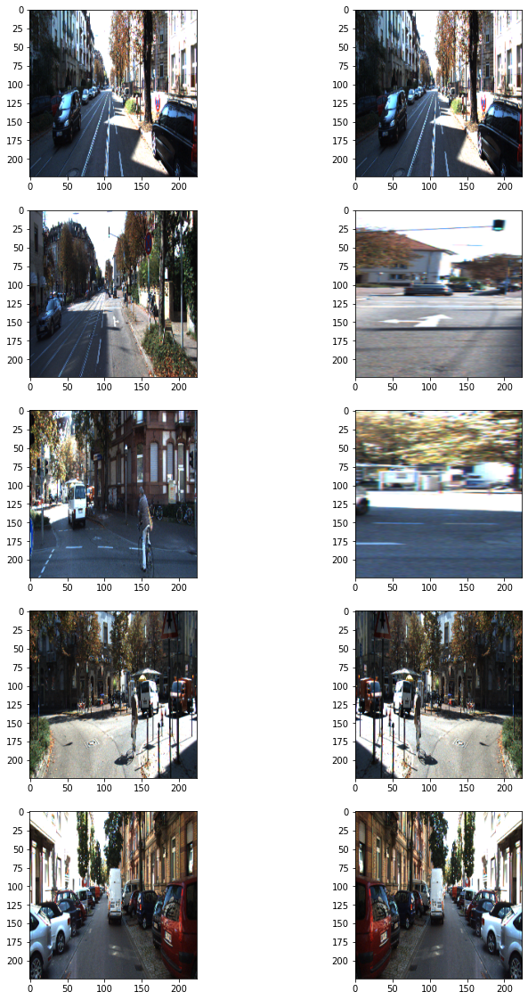

In [ ]:
dir_path = os.getenv('HOME')+'/aiffel/semantic_segmentation/data/training'

augmentation_train = build_augmentation()
augmentation_test = build_augmentation(is_train=False)
input_images = glob(os.path.join(dir_path, "image_2", "*.png"))

# 훈련 데이터셋에서 5개만 가져와 augmentation을 적용해 봅시다.  
plt.figure(figsize=(12, 20))
for i in range(5):
    image = imread(input_images[i]) 
    image_data = {"image":image}
    resized = augmentation_test(**image_data)
    processed = augmentation_train(**image_data)
    plt.subplot(5, 2, 2*i+1)
    plt.imshow(resized["image"])  # 왼쪽이 원본이미지
    plt.subplot(5, 2, 2*i+2)
    plt.imshow(processed["image"])  # 오른쪽이 augment된 이미지
  
plt.show()

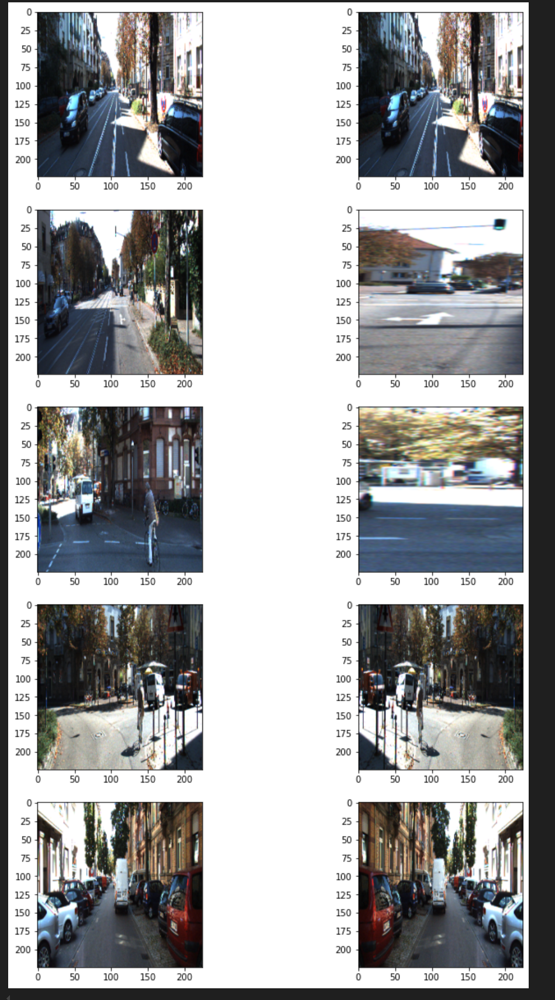

In [ ]:
class KittiGenerator(tf.keras.utils.Sequence):
  '''
  KittiGenerator는 tf.keras.utils.Sequence를 상속받습니다.
  우리가 KittiDataset을 원하는 방식으로 preprocess하기 위해서 Sequnce를 커스텀해 사용합니다.
  '''
  def __init__(self, 
               dir_path,
               batch_size=16,
               img_size=(224, 224, 3),
               output_size=(224, 224),
               is_train=True,
               augmentation=None):
    '''
    dir_path: dataset의 directory path입니다.
    batch_size: batch_size입니다.
    img_size: preprocess에 사용할 입력이미지의 크기입니다.
    output_size: ground_truth를 만들어주기 위한 크기입니다.
    is_train: 이 Generator가 학습용인지 테스트용인지 구분합니다.
    augmentation: 적용하길 원하는 augmentation 함수를 인자로 받습니다.
    '''
    self.dir_path = dir_path
    self.batch_size = batch_size
    self.is_train = is_train
    self.dir_path = dir_path
    self.augmentation = augmentation
    self.img_size = img_size
    self.output_size = output_size

    # load_dataset()을 통해서 kitti dataset의 directory path에서 라벨과 이미지를 확인합니다.
    self.data = self.load_dataset()

  def load_dataset(self):
    # kitti dataset에서 필요한 정보(이미지 경로 및 라벨)를 directory에서 확인하고 로드하는 함수입니다.
    # 이때 is_train에 따라 test set을 분리해서 load하도록 해야합니다.
    input_images = glob(os.path.join(self.dir_path, "image_2", "*.png"))
    label_images = glob(os.path.join(self.dir_path, "semantic", "*.png"))
    input_images.sort()
    label_images.sort()
    assert len(input_images) == len(label_images)
    data = [ _ for _ in zip(input_images, label_images)]

    if self.is_train:
      return data[:-30]
    return data[-30:]
    
  def __len__(self):
    # Generator의 length로서 전체 dataset을 batch_size로 나누고 소숫점 첫째자리에서 올림한 값을 반환합니다.
    return math.ceil(len(self.data) / self.batch_size)

  def __getitem__(self, index):
    # 입력과 출력을 만듭니다.
    # 입력은 resize및 augmentation이 적용된 input image이고 
    # 출력은 semantic label입니다.
    batch_data = self.data[
                           index*self.batch_size:
                           (index + 1)*self.batch_size
                           ]
    inputs = np.zeros([self.batch_size, *self.img_size])
    outputs = np.zeros([self.batch_size, *self.output_size])
        
    for i, data in enumerate(batch_data):
      input_img_path, output_path = data
      _input = imread(input_img_path)
      _output = imread(output_path)
      _output = (_output==7).astype(np.uint8)*1
      data = {
          "image": _input,
          "mask": _output,
          }
      augmented = self.augmentation(**data)
      inputs[i] = augmented["image"]/255
      outputs[i] = augmented["mask"]
    return inputs, outputs

  def on_epoch_end(self):
    # 한 epoch가 끝나면 실행되는 함수입니다. 학습중인 경우에 순서를 random shuffle하도록 적용한 것을 볼 수 있습니다.
    self.indexes = np.arange(len(self.data))
    if self.is_train == True :
      np.random.shuffle(self.indexes)
      return self.indexes

In [ ]:
augmentation = build_augmentation()
test_preproc = build_augmentation(is_train=False)
        
train_generator = KittiGenerator(
    dir_path, 
    augmentation=augmentation,
)

test_generator = KittiGenerator(
    dir_path, 
    augmentation=test_preproc,
    is_train=False
)

# U-NET++모델

In [ ]:
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Conv2DTranspose, concatenate
from tensorflow.keras.models import Model

def conv_block(x, filters):
    x = Conv2D(filters, (3, 3), activation='relu', padding='same')(x)
    x = Conv2D(filters, (3, 3), activation='relu', padding='same')(x)
    return x

def build_unetpp(input_shape=(224, 224, 3)):
    inputs = Input(input_shape)

    # Encoder
    x00 = conv_block(inputs, 64)
    p0 = MaxPooling2D((2, 2))(x00)
    x10 = conv_block(p0, 128)
    p1 = MaxPooling2D((2, 2))(x10)
    x20 = conv_block(p1, 256)
    p2 = MaxPooling2D((2, 2))(x20)
    x30 = conv_block(p2, 512)
    p3 = MaxPooling2D((2, 2))(x30)
    x40 = conv_block(p3, 1024)

    # Decoder with nested skip connections
    x01 = conv_block(concatenate([x00, Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(x10)]), 64)
    x11 = conv_block(concatenate([x10, Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(x20)]), 128)
    x21 = conv_block(concatenate([x20, Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(x30)]), 256)
    x31 = conv_block(concatenate([x30, Conv2DTranspose(512, (2, 2), strides=(2, 2), padding='same')(x40)]), 512)

    x02 = conv_block(concatenate([x00, x01, Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(x11)]), 64)
    x12 = conv_block(concatenate([x10, x11, Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(x21)]), 128)
    x22 = conv_block(concatenate([x20, x21, Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(x31)]), 256)

    x03 = conv_block(concatenate([x00, x01, x02, Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(x12)]), 64)
    x13 = conv_block(concatenate([x10, x11, x12, Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(x22)]), 128)

    x04 = conv_block(concatenate([x00, x01, x02, x03, Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(x13)]), 64)

    outputs = Conv2D(1, (1, 1), activation='sigmoid')(x04)
    model = Model(inputs, outputs)
    return model


In [ ]:
model_path = os.getenv('HOME')+'/aiffel/semantic_segmentation/seg_model_unet2.h5'

model = build_unetpp()
model.compile(optimizer = Adam(1e-4), loss = 'binary_crossentropy')
model.fit(
     train_generator,
     validation_data=test_generator,
     steps_per_epoch=len(train_generator),
     epochs=100,
 )

model.save(model_path)  #학습한 모델을 저장해 주세요.

Epoch 1/100
11/11 [==============================] - 24s 2s/step - loss: 0.6511 - val_loss: 0.6096
Epoch 2/100
11/11 [==============================] - 22s 2s/step - loss: 0.5796 - val_loss: 0.5723
Epoch 3/100
11/11 [==============================] - 20s 2s/step - loss: 0.5265 - val_loss: 0.4435
Epoch 4/100
11/11 [==============================] - 20s 2s/step - loss: 0.3549 - val_loss: 0.3198
Epoch 5/100
11/11 [==============================] - 22s 2s/step - loss: 0.2942 - val_loss: 0.3224
Epoch 6/100
11/11 [==============================] - 20s 2s/step - loss: 0.2689 - val_loss: 0.2957
Epoch 7/100
11/11 [==============================] - 20s 2s/step - loss: 0.2695 - val_loss: 0.2927
Epoch 8/100
11/11 [==============================] - 21s 2s/step - loss: 0.2595 - val_loss: 0.2905
Epoch 9/100
11/11 [==============================] - 20s 2s/step - loss: 0.2256 - val_loss: 0.4008
Epoch 10/100
11/11 [==============================] - 21s 2s/step - loss: 0.2258 - val_loss: 0.2751
Epoch 11/

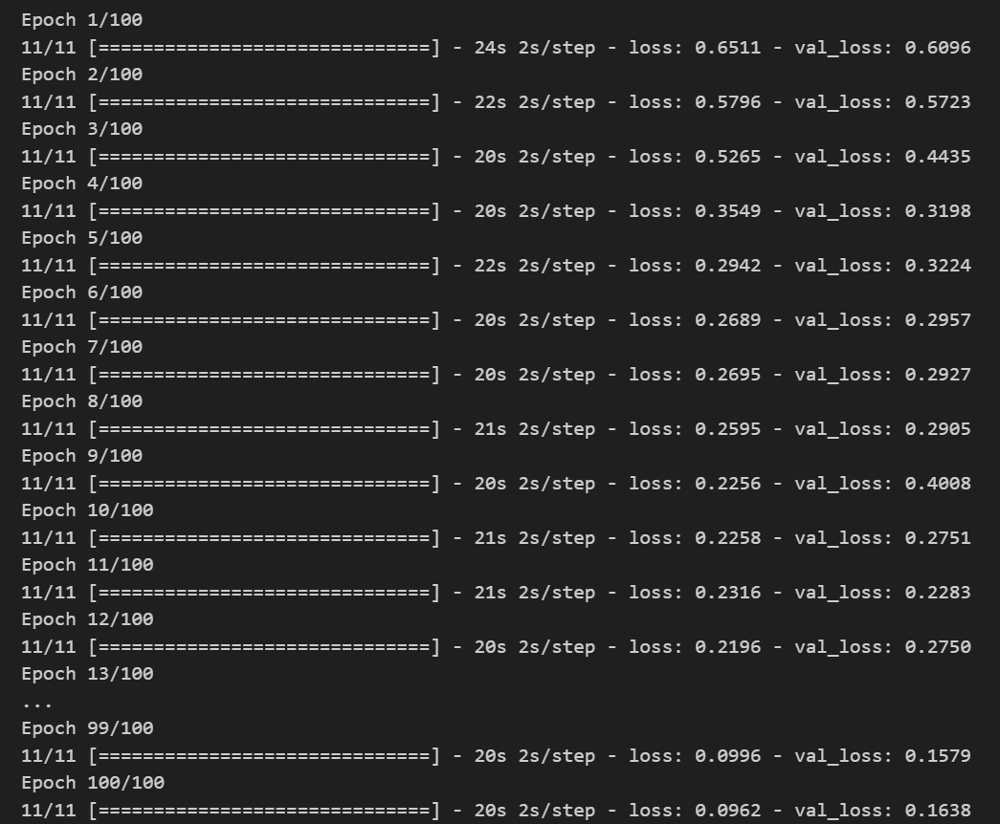

In [ ]:
# 미리 준비한 모델을 불러오려면 아래 주석을 해제하세요
model.save(model_path, save_format='h5')

model = tf.keras.models.load_model(model_path)

In [ ]:
def get_output(model, preproc, image_path, output_path):
     origin_img = imread(image_path)
     data = {"image":origin_img}
     processed = preproc(**data)
     output = model(np.expand_dims(processed["image"]/255,axis=0))
     output = (output[0].numpy()>0.5).astype(np.uint8).squeeze(-1)*255  #0.5라는 threshold를 변경하면 도로인식 결과범위가 달라집니다.
     output = Image.fromarray(output)
     background = Image.fromarray(origin_img).convert('RGBA')
     output = output.resize((origin_img.shape[1], origin_img.shape[0])).convert('RGBA')
     output = Image.blend(background, output, alpha=0.5)
     output.show()
     return output

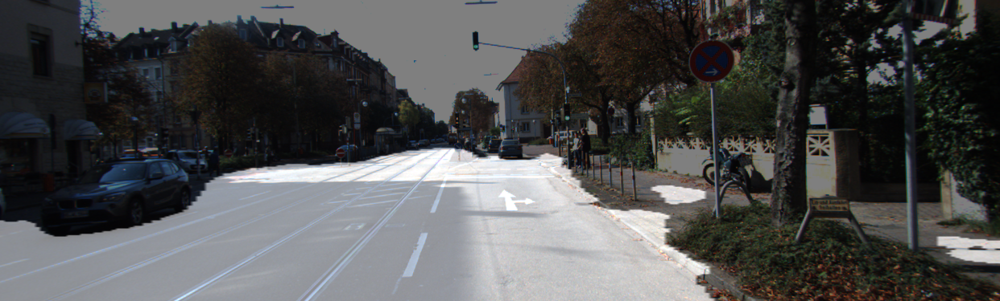

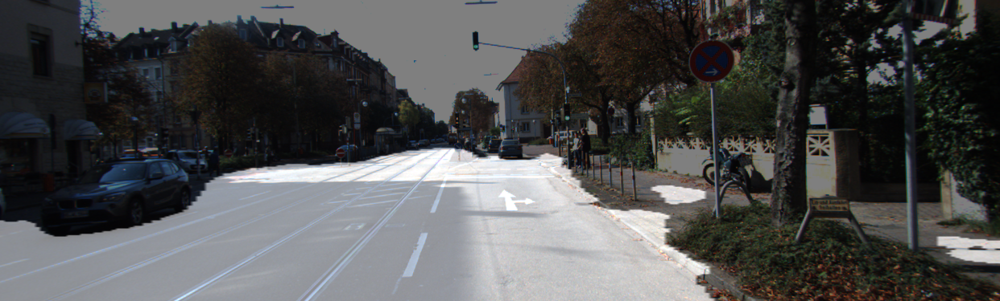

In [ ]:
# 완성한 뒤에는 시각화한 결과를 눈으로 확인해봅시다!
i = 1    # i값을 바꾸면 테스트용 파일이 달라집니다. 
get_output(
     model, 
     test_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
 )

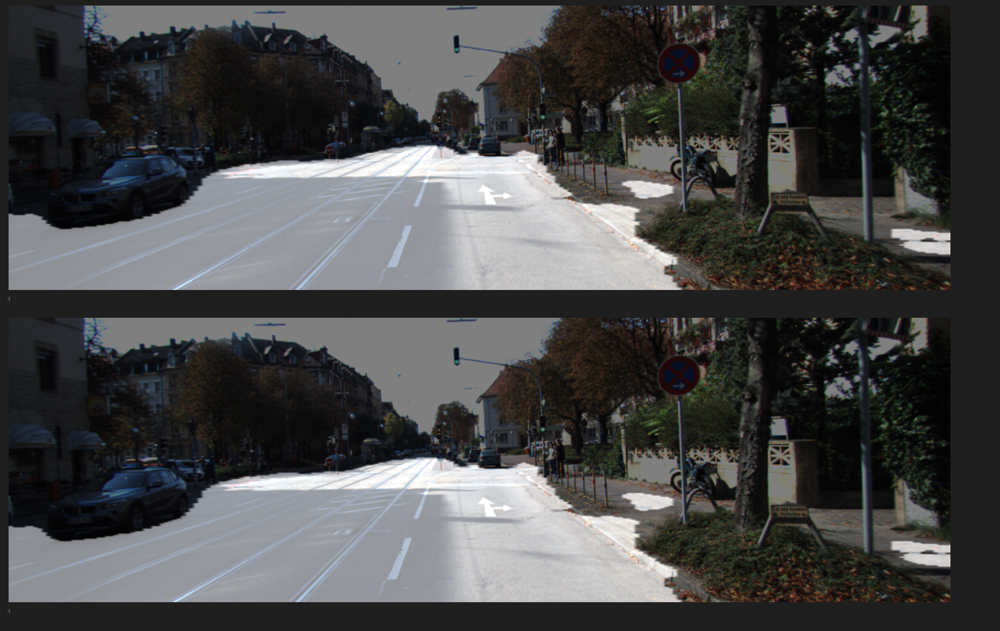

TypeError: unhashable type: 'numpy.ndarray'에러발생 iou_score 계산방식을 변환하여 에러수정

In [31]:
def calculate_iou_score(target, prediction):
    # 이진 마스크로 변환 (0 또는 1)
    target_bin = (target > 0).astype(int)
    pred_bin = (prediction > 0).astype(int)
    
    # 교집합과 합집합 계산
    intersection = np.logical_and(target_bin, pred_bin).sum()
    union = np.logical_or(target_bin, pred_bin).sum()
    
    iou_score = intersection / union if union != 0 else 0.0
    print(f'IoU: {iou_score:.4f}')
    return iou_score


In [35]:
def get_output(model, preproc, image_path, output_path, label_path):
    origin_img = imread(image_path)
    data = {"image": origin_img}
    processed = preproc(**data)
    output = model(np.expand_dims(processed["image"]/255, axis=0))
    output = (output[0].numpy() >= 0.5).astype(np.uint8).squeeze(-1)*255
    prediction = output / 255  # 예측 마스크 (0 또는 1)
    
    # PIL Image 생성
    output_img = Image.fromarray(output)
    background = Image.fromarray(origin_img).convert('RGBA')
    output_img = output_img.resize((origin_img.shape[1], origin_img.shape[0])).convert('RGBA')
    blended = Image.blend(background, output_img, alpha=0.5)
    blended.show()
    
    if label_path:   
        label_img = imread(label_path)
        label_data = {"image": label_img}
        label_processed = preproc(**label_data)
        label_processed = label_processed["image"]
        target = (label_processed == 7).astype(np.uint8)  # 정답 마스크
        return origin_img, blended, prediction, target
    else:
        return origin_img, blended, prediction, None


In [33]:
import matplotlib.pyplot as plt

def visualize_results(original, target, prediction, iou):
    plt.figure(figsize=(15, 5))
    
    # 원본 이미지
    plt.subplot(1,3,1)
    plt.title("Original Image")
    plt.imshow(original)
    plt.axis('off')
    
    # 정답 마스크 (Ground Truth)
    plt.subplot(1,3,2)
    plt.title("True Mask")
    plt.imshow(target, cmap='gray')
    plt.axis('off')
    
    # 예측 마스크 (Prediction)
    plt.subplot(1,3,3)
    plt.title(f"Predicted Mask (IoU: {iou:.4f})")
    plt.imshow(prediction, cmap='gray')
    plt.axis('off')
    
    plt.tight_layout()
    plt.show()


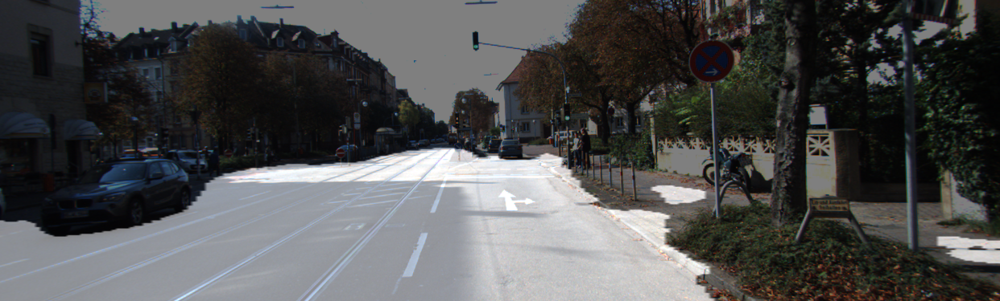

IoU: 0.9064


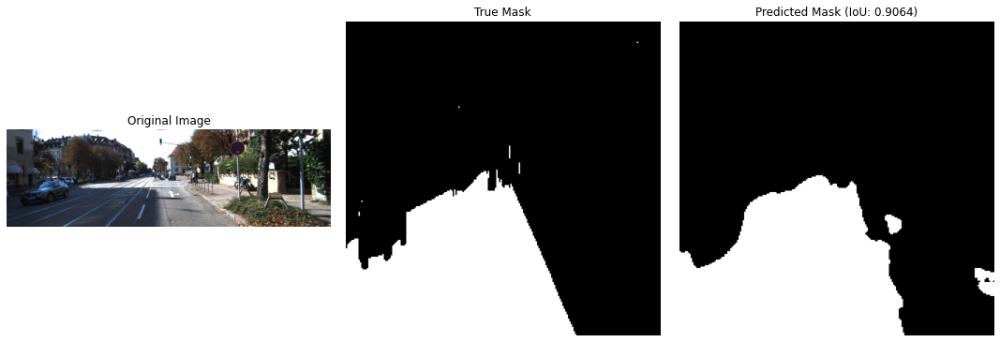

In [37]:
i = 1
# 4개 변수로 받기
origin_img, output, prediction, target = get_output(
    model, 
    test_preproc,
    image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
    output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
    label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
)

iou = calculate_iou_score(target, prediction)
visualize_results(origin_img, target, prediction, iou)  # origin_img 사용


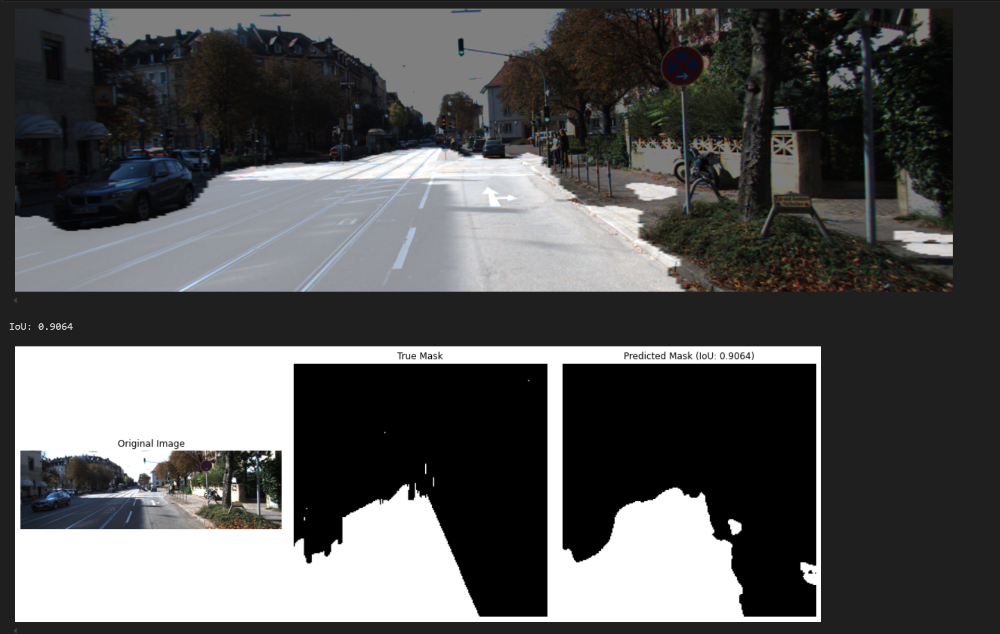

# U-NET모델

In [38]:
def build_model(input_shape=(224, 224, 3)):
    inputs = Input(input_shape)
    
    # Encoder (downsampling path)
    # Block 1
    c1 = Conv2D(64, (3, 3), activation='relu', padding='same')(inputs)
    c1 = Conv2D(64, (3, 3), activation='relu', padding='same')(c1)
    p1 = MaxPooling2D((2, 2))(c1)
    
    # Block 2
    c2 = Conv2D(128, (3, 3), activation='relu', padding='same')(p1)
    c2 = Conv2D(128, (3, 3), activation='relu', padding='same')(c2)
    p2 = MaxPooling2D((2, 2))(c2)
    
    # Block 3
    c3 = Conv2D(256, (3, 3), activation='relu', padding='same')(p2)
    c3 = Conv2D(256, (3, 3), activation='relu', padding='same')(c3)
    p3 = MaxPooling2D((2, 2))(c3)
    
    # Block 4
    c4 = Conv2D(512, (3, 3), activation='relu', padding='same')(p3)
    c4 = Conv2D(512, (3, 3), activation='relu', padding='same')(c4)
    p4 = MaxPooling2D((2, 2))(c4)
    
    # Bottleneck
    c5 = Conv2D(1024, (3, 3), activation='relu', padding='same')(p4)
    c5 = Conv2D(1024, (3, 3), activation='relu', padding='same')(c5)
    
    # Decoder (upsampling path)
    # Block 6
    u6 = Conv2DTranspose(512, (2, 2), strides=(2, 2), padding='same')(c5)
    u6 = concatenate([u6, c4])
    c6 = Conv2D(512, (3, 3), activation='relu', padding='same')(u6)
    c6 = Conv2D(512, (3, 3), activation='relu', padding='same')(c6)
    
    # Block 7
    u7 = Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(c6)
    u7 = concatenate([u7, c3])
    c7 = Conv2D(256, (3, 3), activation='relu', padding='same')(u7)
    c7 = Conv2D(256, (3, 3), activation='relu', padding='same')(c7)
    
    # Block 8
    u8 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(c7)
    u8 = concatenate([u8, c2])
    c8 = Conv2D(128, (3, 3), activation='relu', padding='same')(u8)
    c8 = Conv2D(128, (3, 3), activation='relu', padding='same')(c8)
    
    # Block 9
    u9 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(c8)
    u9 = concatenate([u9, c1])
    c9 = Conv2D(64, (3, 3), activation='relu', padding='same')(u9)
    c9 = Conv2D(64, (3, 3), activation='relu', padding='same')(c9)
    
    # Output layer
    outputs = Conv2D(1, (1, 1), activation='sigmoid')(c9)
    
    model = Model(inputs=[inputs], outputs=[outputs])
    return model


In [39]:
model_path = os.getenv('HOME')+'/aiffel/semantic_segmentation/seg_model_unet.h5'

model = build_model()
model.compile(optimizer = Adam(1e-4), loss = 'binary_crossentropy')
model.fit(
     train_generator,
     validation_data=test_generator,
     steps_per_epoch=len(train_generator),
     epochs=100,
 )

model.save(model_path)  #학습한 모델을 저장해 주세요.

Epoch 1/100
11/11 [==============================] - 22s 2s/step - loss: 0.6627 - val_loss: 0.6224
Epoch 2/100
11/11 [==============================] - 11s 955ms/step - loss: 0.6132 - val_loss: 0.6065
Epoch 3/100
11/11 [==============================] - 11s 995ms/step - loss: 0.5980 - val_loss: 0.5414
Epoch 4/100
11/11 [==============================] - 11s 967ms/step - loss: 0.5586 - val_loss: 0.5311
Epoch 5/100
11/11 [==============================] - 12s 1s/step - loss: 0.4115 - val_loss: 0.3528
Epoch 6/100
11/11 [==============================] - 17s 2s/step - loss: 0.3484 - val_loss: 0.5348
Epoch 7/100
11/11 [==============================] - 12s 1s/step - loss: 0.3308 - val_loss: 0.3051
Epoch 8/100
11/11 [==============================] - 11s 977ms/step - loss: 0.2995 - val_loss: 0.2696
Epoch 9/100
11/11 [==============================] - 11s 978ms/step - loss: 0.2628 - val_loss: 0.2613
Epoch 10/100
11/11 [==============================] - 12s 1s/step - loss: 0.2544 - val_loss: 0

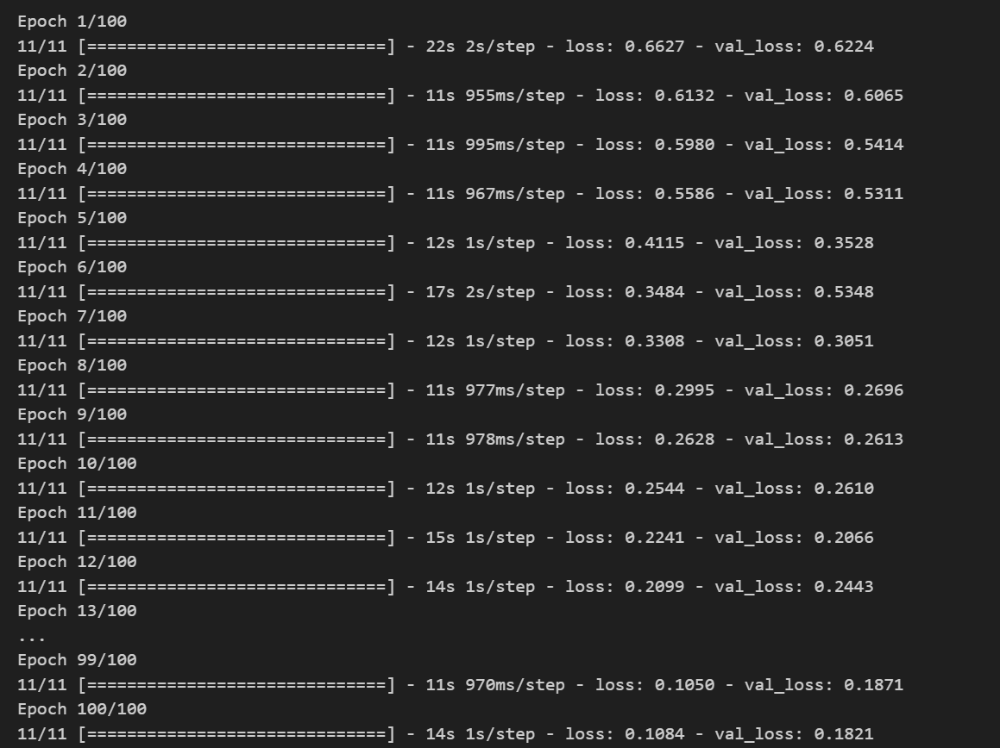

In [55]:
# 미리 준비한 모델을 불러오려면 아래 주석을 해제하세요
unet_model = tf.keras.models.load_model(model_path)

In [56]:
def get_output(model, preproc, image_path, output_path, label_path=None):
    origin_img = imread(image_path)
    data = {"image": origin_img}
    processed = preproc(**data)
    output = model(np.expand_dims(processed["image"]/255, axis=0))
    output = (output[0].numpy() >= 0.5).astype(np.uint8).squeeze(-1)*255
    prediction = output / 255
    
    # PIL Image 생성
    output_img = Image.fromarray(output)
    background = Image.fromarray(origin_img).convert('RGBA')
    output_img = output_img.resize((origin_img.shape[1], origin_img.shape[0])).convert('RGBA')
    blended = Image.blend(background, output_img, alpha=0.5)
    blended.show()
    
    if label_path:   
        label_img = imread(label_path)
        label_data = {"image": label_img}
        label_processed = preproc(**label_data)
        label_processed = label_processed["image"]
        target = (label_processed == 7).astype(np.uint8)
        return origin_img, blended, prediction, target  # 4개 반환
    else:
        return origin_img, blended, prediction  # 3개 반환


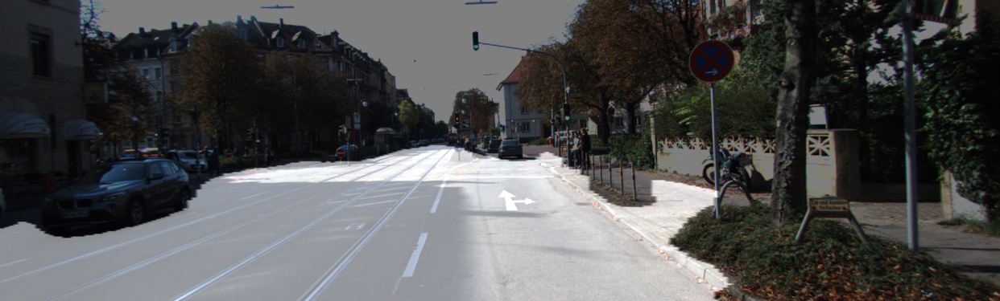

(array([[[ 68,  78,  83],
         [ 69,  79,  79],
         [ 73,  78,  77],
         ...,
         [ 56,  41,  37],
         [ 55,  41,  38],
         [ 50,  43,  38]],
 
        [[ 67,  79,  84],
         [ 67,  79,  89],
         [ 72,  79,  89],
         ...,
         [ 59,  42,  36],
         [ 54,  43,  35],
         [ 46,  44,  35]],
 
        [[ 74,  76,  83],
         [ 73,  79,  90],
         [ 74,  79,  92],
         ...,
         [ 57,  44,  32],
         [ 53,  45,  29],
         [ 50,  45,  31]],
 
        ...,
 
        [[ 26,  33,  42],
         [ 26,  35,  44],
         [ 27,  36,  45],
         ...,
         [161,  52,  38],
         [112,  41,  38],
         [ 82,  30,  31]],
 
        [[ 26,  33,  43],
         [ 25,  36,  45],
         [ 27,  36,  45],
         ...,
         [166,  58,  38],
         [129,  56,  35],
         [ 87,  56,  42]],
 
        [[ 30,  34,  43],
         [ 30,  34,  45],
         [ 28,  34,  45],
         ...,
         [ 67,  76,  38],
  

In [57]:
# 완성한 뒤에는 시각화한 결과를 눈으로 확인해봅시다!
i = 1    # i값을 바꾸면 테스트용 파일이 달라집니다. 
get_output(
     model, 
     test_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
 )

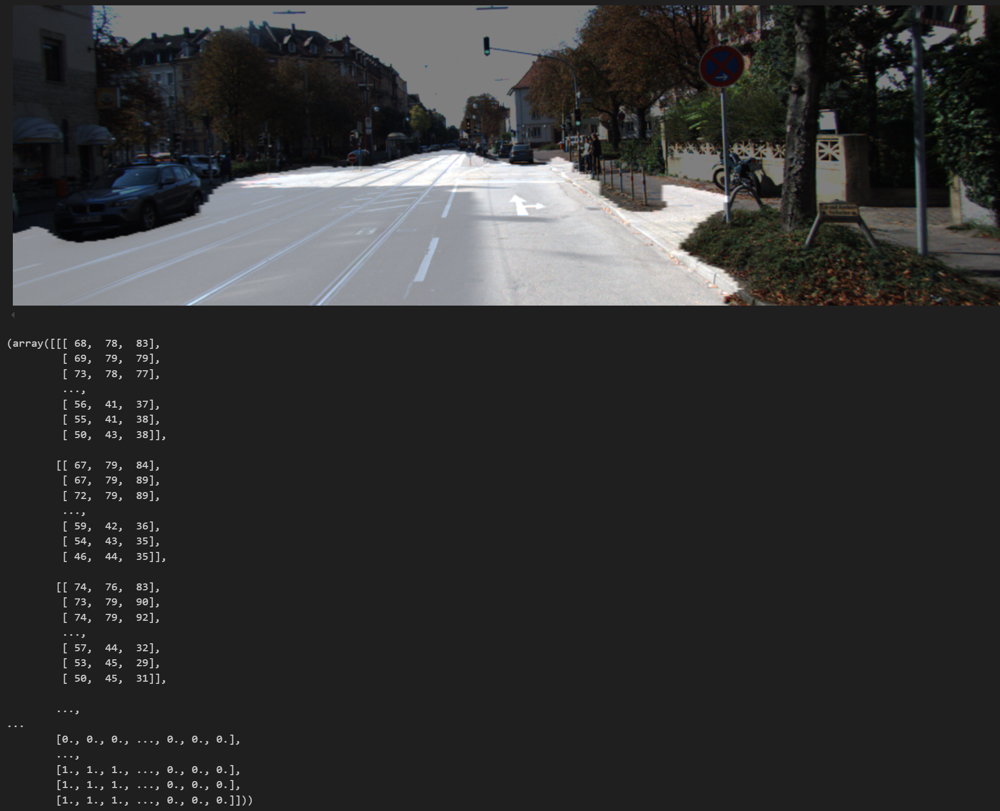

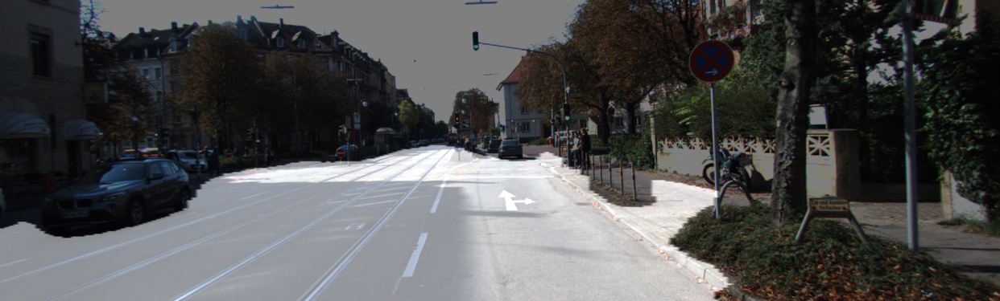

IoU: 0.8908


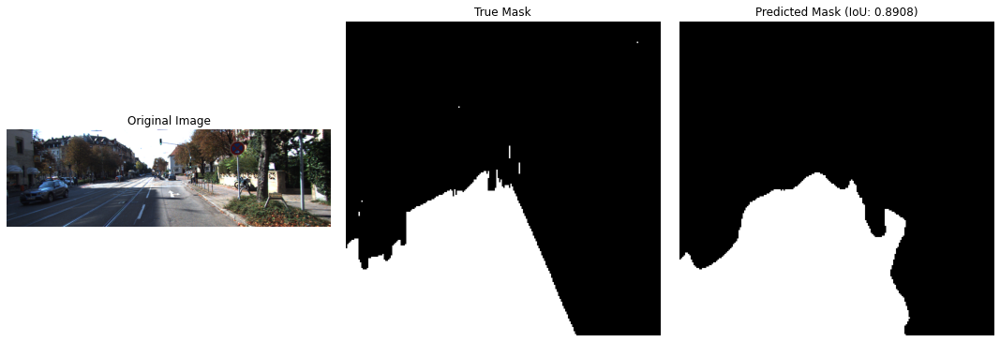

In [58]:
i = 1
# 4개 변수로 받기 (라벨 경로 제공 시)
origin_img, output, prediction, target = get_output(
    model, 
    test_preproc,
    image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
    output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
    label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
)

iou = calculate_iou_score(target, prediction)
visualize_results(origin_img, target, prediction, iou)  # 정상 작동


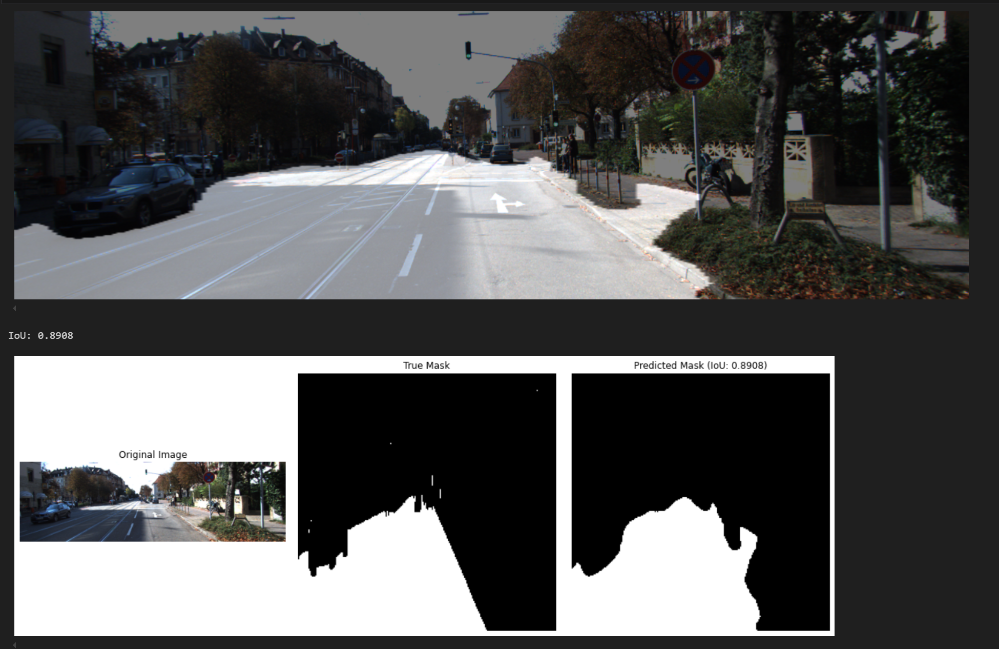

Step 3. U-Net 과 U-Net++ 모델이 수행한 세그멘테이션 결과 분석

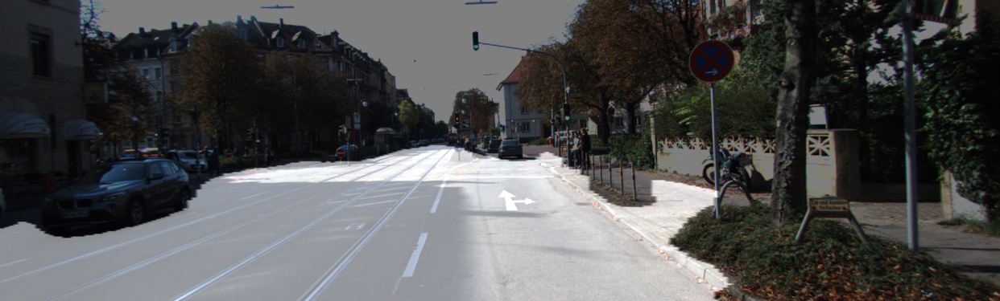

IoU: 0.8908


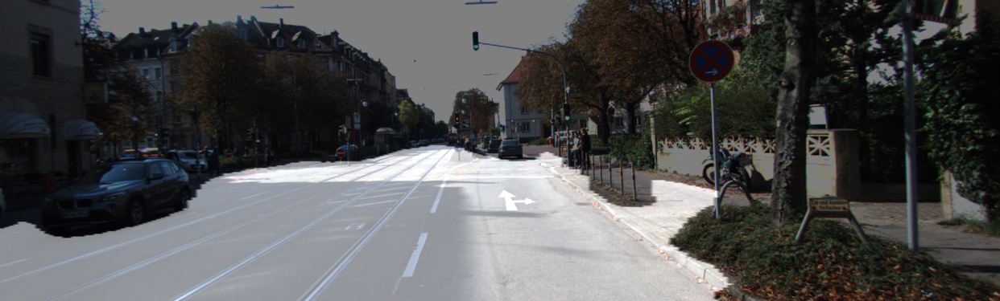

IoU: 0.8908


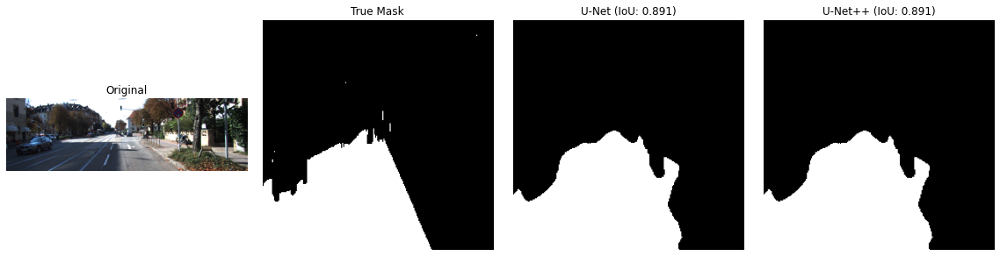

In [59]:
i = 1  # 테스트할 이미지 인덱스

# 1. U-Net 결과 얻기
origin_img, output_unet, pred_unet, target = get_output(
    unet_model,             # U-Net 모델 변수명
    test_preproc,
    image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
    output_path=dir_path + f'./result_unet_{str(i).zfill(3)}.png',
    label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
)
iou_unet = calculate_iou_score(target, pred_unet)

# 2. U-Net++ 결과 얻기
origin_img, output_unetpp, pred_unetpp, target = get_output(
    model,                  # U-Net++ 모델 변수명
    test_preproc,
    image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
    output_path=dir_path + f'./result_unetpp_{str(i).zfill(3)}.png',
    label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
)
iou_unetpp = calculate_iou_score(target, pred_unetpp)

# 3. 시각적 비교
import matplotlib.pyplot as plt
plt.figure(figsize=(16, 4))
plt.subplot(1,4,1)
plt.title("Original")
plt.imshow(origin_img)
plt.axis('off')

plt.subplot(1,4,2)
plt.title("True Mask")
plt.imshow(target, cmap='gray')
plt.axis('off')

plt.subplot(1,4,3)
plt.title(f"U-Net (IoU: {iou_unet:.3f})")
plt.imshow(pred_unet, cmap='gray')
plt.axis('off')

plt.subplot(1,4,4)
plt.title(f"U-Net++ (IoU: {iou_unetpp:.3f})")
plt.imshow(pred_unetpp, cmap='gray')
plt.axis('off')

plt.tight_layout()
plt.show()


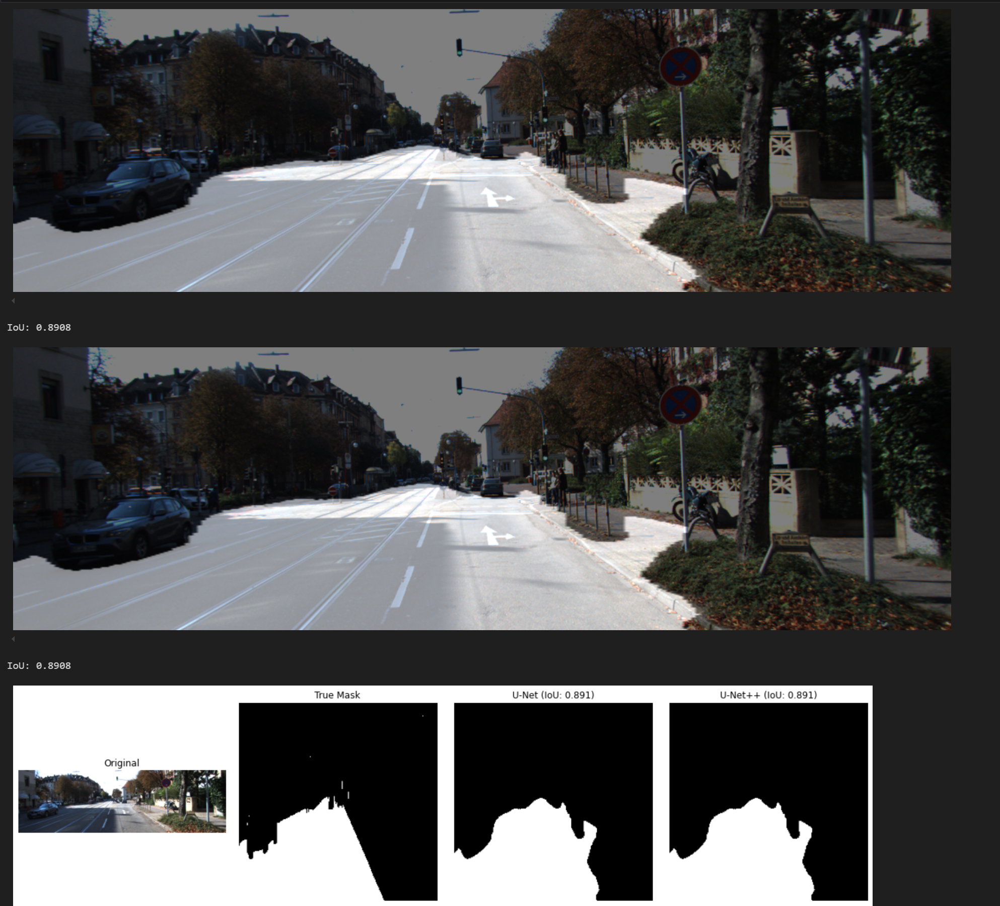

In [ ]:
def calculate_iou(y_true, y_pred, threshold=0.5):
    y_pred_bin = (y_pred > threshold).astype(int)
    intersection = (y_true & y_pred_bin).sum()
    union = (y_true | y_pred_bin).sum()
    return intersection / union if union != 0 else 0

iou_unet = calculate_iou(test_mask, unet_pred)
iou_unetpp = calculate_iou(test_mask, unetpp_pred)
print(f"U-Net IoU: {iou_unet:.4f} / U-Net++ IoU: {iou_unetpp:.4f}")


In [60]:
# U-Net과 U-Net++의 IoU 계산 (동일한 테스트 이미지)
iou_unet = calculate_iou_score(target, pred_unet)  
iou_unetpp = calculate_iou_score(target, pred_unetpp)  
print(f"U-Net IoU: {iou_unet:.4f}, U-Net++ IoU: {iou_unetpp:.4f}")  


IoU: 0.8908
IoU: 0.8908
U-Net IoU: 0.8908, U-Net++ IoU: 0.8908


# 회고
U-Net과 U-Net++ 두 가지 구조를 직접 구현했습니다.
U-Net++의 경우, 논문에서 제시한 nested skip connection 구조를 코드로 옮기는 과정이 쉽지 않았지만,
여러 단계의 피처맵을 중첩적으로 연결하는 부분을 함수화하여 코드의 가독성과 재사용성을 높였습니다.
두 모델 모두 동일한 데이터셋, 동일한 전처리, 동일한 하이퍼파라미터(optimizer, loss, epoch 등)로 학습을 진행해
공정한 성능 비교가 가능하도록 했습니다.
원본 이미지, 정답 마스크, U-Net 예측, U-Net++ 예측을 한 화면에 시각화하여
경계선의 정밀도, 작은 객체의 분할 등에서 실제 차이를 관찰했습니다.
한두 장의 쉬운 이미지에서는 두 모델의 IoU와 시각화 결과가 거의 차이가 없을 수 있다는 점을 경험했습니다.
복잡한 경계, 작은 객체가 포함된 다양한 이미지를 대상으로 평균 성능을 비교하는 것이
모델의 진짜 우수성을 평가하는 데 중요하다는 사실을 알게 되었습니다.
U-Net++ 구조가 논문과 다르게 구현되면 U-Net과 성능 차이가 거의 없을 수 있습니다.
논문 구조를 코드로 옮길 때는 skip connection, deep supervision 등 세부 구조를 꼼꼼히 반영해야 함을 다시 한 번 깨달았습니다.
모델 저장/불러오기, 변수명 혼동, 데이터셋 분리 등 사소해 보이는 실수가
실험 결과에 큰 영향을 줄 수 있으니, 항상 꼼꼼하게 점검해야 함을 느꼈습니다.

다양한 난이도의 테스트셋에서 평균 IoU, Dice, Precision 등 여러 지표로 비교해보기,U-Net++의 deep supervision, 하이퍼파라미터 튜닝, loss function 다양화 등 추가 실험,실시간 추론 속도, 메모리 사용량 등 실용적 관점도 함께 평가해보기 등을 더 해보면 좋을 것 같습니다.